# Pre-requisite checks

In [1]:
# check environment settings
!conda info


     active environment : base
    active env location : /Users/dsm2k2c/anaconda3/envs/knights_algorithm
            shell level : 3
       user config file : /Users/dsm2k2c/.condarc
 populated config files : /Users/dsm2k2c/.condarc
          conda version : 24.7.1
    conda-build version : not installed
         python version : 3.11.9.final.0
                 solver : libmamba (default)
       virtual packages : __archspec=1=skylake
                          __conda=24.7.1=0
                          __osx=10.16=0
                          __unix=0=0
       base environment : /Users/dsm2k2c/anaconda3/envs/knights_algorithm  (writable)
      conda av data dir : /Users/dsm2k2c/anaconda3/envs/knights_algorithm/etc/conda
  conda av metadata url : None
           channel URLs : https://repo.anaconda.com/pkgs/main/osx-64
                          https://repo.anaconda.com/pkgs/main/noarch
                          https://repo.anaconda.com/pkgs/r/osx-64
                          https://r

# Import packages

In [2]:
# update to latest conda version to get supported packages
!conda update --yes conda

Channels:
 - defaults
 - conda-forge
Platform: osx-64
Solving environment: done

# All requested packages already installed.



In [3]:
# setting up additonal channels to check for packages
!conda config --append channels conda-forge

In [4]:
# common utils
import os
from pathlib import Path
from IPython import display
import datetime as dt

# visualisation
import matplotlib.pyplot as plt

%matplotlib inline

# Watermarking the notebook
#!conda install --yes --prefix {sys.prefix} watermark
%load_ext watermark
%watermark -d -m -v -p numpy,matplotlib,pandas

Python implementation: CPython
Python version       : 3.11.9
IPython version      : 8.25.0

numpy     : 1.26.4
matplotlib: 3.8.4
pandas    : 2.2.2

Compiler    : Clang 14.0.6 
OS          : Darwin
Release     : 23.6.0
Machine     : x86_64
Processor   : i386
CPU cores   : 12
Architecture: 64bit



# Industrialization - cycle settings

In [5]:
# defining varibales to be used for industrialization
odate = dt.datetime.today().strftime("%Y-%m-%d")
cycle = ""
project_name = "knights_algorithm"
version = "v1_basic_algorithm"

# relative paths often cause file read/write errors. Always start from project_root variable to avoid time loss in resolving path errors
current_working_directory = os.getcwd()
if (
    current_working_directory
    != f"/Users/dsm2k2c/Documents/projects/{project_name}/notebooks"
):
    project_root = Path(f"/Users/dsm2k2c/Documents/projects/{project_name}")
    print("ATTENTION! Check current working directory!")
else:
    project_root = Path(os.path.dirname(current_working_directory))

# recording progress
print("date of run: ", odate)
print("project path: ", project_root)
print("project name: ", project_name)
print("progress stage: ", version)

date of run:  2024-08-31
project path:  /Users/dsm2k2c/Documents/projects/knights_algorithm
project name:  knights_algorithm
progress stage:  v1_basic_algorithm


In [6]:
# set path for data folder
data_folder = project_root / "data"
print("Data folder path: ", data_folder)

Data folder path:  /Users/dsm2k2c/Documents/projects/knights_algorithm/data


# Display Keypad

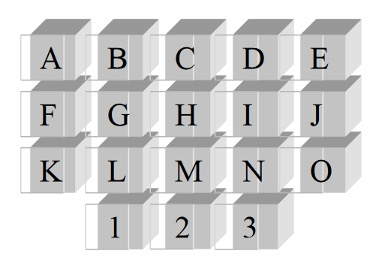

In [7]:
display.Image(data_folder / "keypad_structure.jpg")

# Define Variables needed

In [8]:
# Map each element of the keypad to a coordinate that reflects the relative position of the keys
keypad = {
    "A": (0, 0),
    "B": (0, 1),
    "C": (0, 2),
    "D": (0, 3),
    "E": (0, 4),
    "F": (1, 0),
    "G": (1, 1),
    "H": (1, 2),
    "I": (1, 3),
    "J": (1, 4),
    "K": (2, 0),
    "L": (2, 1),
    "M": (2, 2),
    "N": (2, 3),
    "O": (2, 4),
    "1": (3, 1),
    "2": (3, 2),
    "3": (3, 3),
}

In [9]:
# Define the valid knight moves using the x and y coordinates
knight_moves = [
    (2, 1),
    (2, -1),
    (-2, 1),
    (-2, -1),  # Vertical L-shape moves
    (1, 2),
    (1, -2),
    (-1, 2),
    (-1, -2),  # Horizontal L-shape moves
]

In [10]:
# Define the identification of the constraint: vowels on the keypad
vowels = {"A", "E", "I", "O"}

# Define Global Functions

In [11]:
# function to check if a move is within the bounds of the keypad or not
def is_valid_move(x, y):
    """Check keypad bounds. Keep in mind that the top 3 rows have different number of keys than the last row"""
    return (0 <= x <= 2 and 0 <= y <= 4) or (x == 3 and 1 <= y <= 3)

In [12]:
# function to find all possible sequences
def find_sequences(start_key, sequence, vowels_count):
    if len(sequence) == 10:
        # Found a valid sequence of length 10
        print(sequence)
        return

    current_pos = keypad[start_key]

    for move in knight_moves:
        new_x, new_y = current_pos[0] + move[0], current_pos[1] + move[1]
        if is_valid_move(new_x, new_y):
            # Find the key at the new position
            for key, pos in keypad.items():
                if pos == (new_x, new_y):
                    new_vowels_count = vowels_count + (1 if key in vowels else 0)
                    if new_vowels_count <= 2:
                        find_sequences(key, sequence + key, new_vowels_count)

In [13]:
# function to get all possible sequences
def generate_knight_sequences():
    for key in keypad.keys():
        find_sequences(key, key, 1 if key in vowels else 0)

In [14]:
%%time
# Call the function to generate all sequences
generate_knight_sequences()

ALCNENCNCN
ALCNENCNCL
ALCNENCNCJ
ALCNENCNCF
ALCNENCN1H
ALCNENCN1F
ALCNENCN1N
ALCNENCNG2
ALCNENCNGN
ALCNENCNGD
ALCNENCLCN
ALCNENCLCL
ALCNENCLCJ
ALCNENCLCF
ALCNENCL3J
ALCNENCL3H
ALCNENCL3L
ALCNENCJ3J
ALCNENCJ3H
ALCNENCJ3L
ALCNENCJMD
ALCNENCJMB
ALCNENCJMJ
ALCNENCJMF
ALCNENCJCN
ALCNENCJCL
ALCNENCJCJ
ALCNENCJCF
ALCNENCF1H
ALCNENCF1F
ALCNENCF1N
ALCNENCFMD
ALCNENCFMB
ALCNENCFMJ
ALCNENCFMF
ALCNENCFCN
ALCNENCFCL
ALCNENCFCJ
ALCNENCFCF
ALCNEN1H3J
ALCNEN1H3H
ALCNEN1H3L
ALCNEN1H1H
ALCNEN1H1F
ALCNEN1H1N
ALCNEN1HKB
ALCNEN1HK2
ALCNEN1HKH
ALCNEN1F1H
ALCNEN1F1F
ALCNEN1F1N
ALCNEN1FMD
ALCNEN1FMB
ALCNEN1FMJ
ALCNEN1FMF
ALCNEN1FCN
ALCNEN1FCL
ALCNEN1FCJ
ALCNEN1FCF
ALCNEN1NCN
ALCNEN1NCL
ALCNEN1NCJ
ALCNEN1NCF
ALCNEN1N1H
ALCNEN1N1F
ALCNEN1N1N
ALCNEN1NG2
ALCNEN1NGN
ALCNEN1NGD
ALCNENG2G2
ALCNENG2GN
ALCNENG2GD
ALCNENG2KB
ALCNENG2K2
ALCNENG2KH
ALCNENGNCN
ALCNENGNCL
ALCNENGNCJ
ALCNENGNCF
ALCNENGN1H
ALCNENGN1F
ALCNENGN1N
ALCNENGNG2
ALCNENGNGN
ALCNENGNGD
ALCNENGDMD
ALCNENGDMB
ALCNENGDMJ
ALCNENGDMF
ALCNENGDG2
ALCNENGDGN